# WoundVision Image Segmentation

## Import Necessary Libraries

In [1]:
import cv2
import numpy as np
import random
import glob
import os
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
from matplotlib import colors
from matplotlib.colors import hsv_to_rgb
from matplotlib import pyplot as plt

from keras.preprocessing.image import img_to_array
import tensorflow as tf
from tensorflow.keras.preprocessing import image

from skimage.segmentation import watershed
from skimage.feature import peak_local_max
from scipy import ndimage as ndi

## Read image dataset into Python

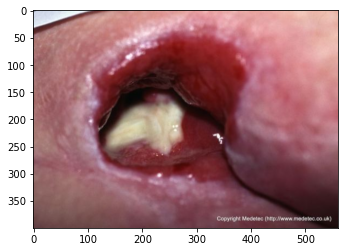

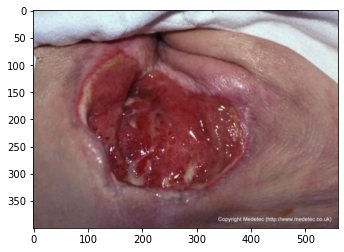

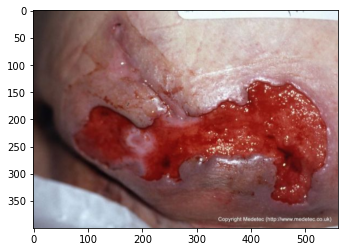

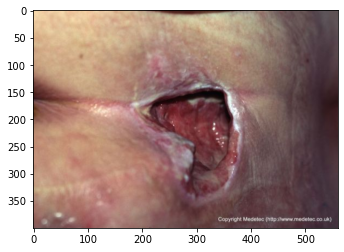

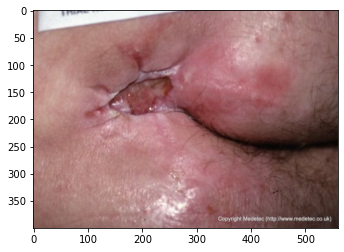

...

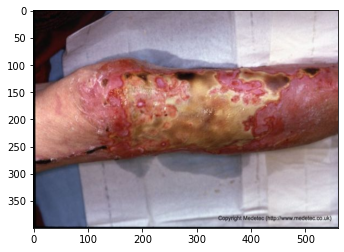

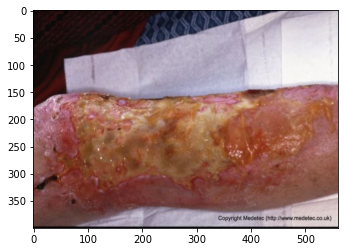

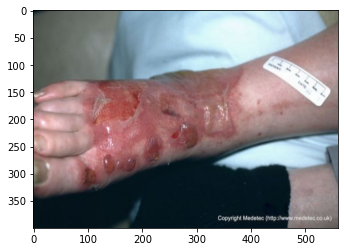

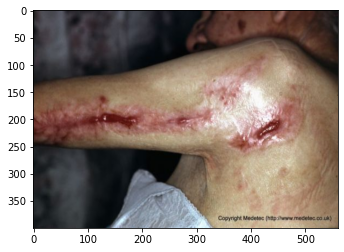

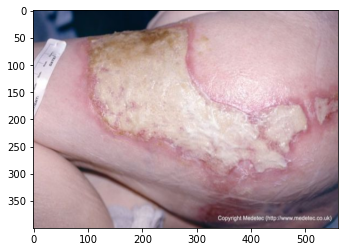

In [2]:
# create path object that specifies the directory and file type our model wishes to target 

pressure = glob.glob("Wound_Dataset/Pressure Sores/*.jpg")
meningitus = glob.glob("Wound_Dataset/Meningitus/*.jpg")
burns = glob.glob("Wound_Dataset/Burns/*.jpg")

# create empty array wound_dataset to hold the images
wound_dataset = []

for file in pressure:
    # initialise object img that holds the currently iterated wound image 'file'
    img = cv2.imread(file)

    # add the object img into wound_dataset
    wound_dataset.append(img)

for file in meningitus:
    img = cv2.imread(file)
    wound_dataset.append(img)
    
for file in burns:
    img = cv2.imread(file)
    wound_dataset.append(img)

for image in wound_dataset:
    
    # OpenCV uses BGR colour codes opposed to RGB making it display a blue image, this step converts it to RGB
    # to display the regular image
    RGB_image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    # Resize the wounds to 560 by 400 to maintain consistent size based on the average size of original images 
    # that fit a whole aspect ratio (7:5)
    Resized_image = cv2.resize(RGB_image, (560, 400))
    
    plt.imshow(Resized_image)
    plt.show()

## Entire Dataset Version

In [3]:
# Initialise word_count value used to give unique names to each iteration's
# saved images
wound_count = 0

# define path of directory user wishes images are saved into
path = 'Model isolated skin'

HSV_mask_dataset =[]
HSV_skin_dataset = []

YCbCr_mask_dataset = []
YCbCr_skin_dataset = []

for image in wound_dataset:
    
    # Make a copy of image being iterated into RGB for later use
    img = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    # Create object that holds the conversion of image from RGB to HSV
    wound_HSV = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)

    # define HSV mask using range of where skin colour exists
    HSV_mask = cv2.inRange(wound_HSV, (0, 5, 0), (17,170,255)) 
    HSV_mask = cv2.morphologyEx(HSV_mask, cv2.MORPH_OPEN, np.ones((3,3), np.uint8))

    
    
    # Create object that holds the conversion of wound image from BGR 
    # (open CV's default colour space) to YCrCb
    wound_YCrCb = cv2.cvtColor(image, cv2.COLOR_BGR2YCrCb)

    # define YCrCb mask using range of where skin colour exists
    YCrCb_mask = cv2.inRange(wound_YCrCb, (0, 135, 85), (255,180,135)) 
    YCrCb_mask = cv2.morphologyEx(YCrCb_mask, cv2.MORPH_OPEN, np.ones((3,3), np.uint8))
    
    
    HSV_result = cv2.bitwise_not(HSV_mask)
    YCrCb_result = cv2.bitwise_not(YCrCb_mask)
    
    # Create wound images cropped using respective masks
    YCrCb_wound = cv2.bitwise_and(image, image, mask=YCrCb_mask)
    HSV_wound = cv2.bitwise_and(img, img, mask=HSV_mask)
    
    HSV_wound = cv2.cvtColor(HSV_wound, cv2.COLOR_BGR2RGB)
    
    
    HSV_mask_dataset.append(HSV_mask)
    HSV_skin_dataset.append(HSV_wound)
    
    YCbCr_mask_dataset.append(YCrCb_mask)
    
    YCbCr_skin_dataset.append(YCrCb_wound)
    
    # Save images into directory
    # str(wound_count) increases by 1 every iteration ensuring that images aren't saved over
    # by the subsequent iteration
    
    cv2.imwrite(os.path.join(path, str(wound_count) + " " + "0_Original_Image.jpg"), image)
    cv2.imwrite(os.path.join(path, str(wound_count) + " " + "1_YCbCr_Mask.jpg"),YCrCb_result)
    cv2.imwrite(os.path.join(path, str(wound_count) + " " + "2_YCbCr_Image.jpg"),YCrCb_wound)
    cv2.imwrite(os.path.join(path, str(wound_count) + " " + "3_HSV_Mask.jpg"), HSV_result)
    cv2.imwrite(os.path.join(path, str(wound_count) + " " + "4_HSV_Image.jpg"),HSV_wound)
    cv2.waitKey(0)
    cv2.destroyAllWindows()  
    wound_count+=1
    cv2.waitKey(0)


In [ ]:
# Gapfilling, paste into above cell when needed for user

# Gapfilling 

    YCrCb_floodfill = YCrCb_mask.copy()
    h, w = YCrCb_mask.shape[:2]

    mask = np.zeros((h+2, w+2), np.uint8)

    cv2.floodFill(YCrCb_floodfill, mask, (0,0), 255);

    # Invert floodfilled image
    YCrCb_floodfill_inv = cv2.bitwise_not(YCrCb_floodfill)

    # Combine the two images to get the foreground.
    YCrCb_out = YCrCb_mask | YCrCb_floodfill_inv

    YCrCb_floodfill_wound = cv2.bitwise_and(image, image, mask=YCrCb_floodfill)
    YCrCb_floodfill_inv_wound = cv2.bitwise_and(image, image, mask=YCrCb_floodfill_inv)
    YCrCb_out_wound = cv2.bitwise_and(image, image, mask=YCrCb_out)

    # End of Gapfilling

    # Display images.
    cv2.imshow("Thresholded Image", YCrCb_result)
    cv2.imshow("Thresh Image", YCrCb_wound)
    cv2.imshow("Floodfilled Image", YCrCb_floodfill)
    cv2.imshow("Flood Image",  YCrCb_floodfill_wound)
    cv2.imshow("Inverted Floodfilled Image", YCrCb_floodfill_inv)
    cv2.imshow("Invert Flood Image", YCrCb_floodfill_inv_wound)
    cv2.imshow("Foreground", YCrCb_out)
    cv2.imshow("Fore", YCrCb_out_wound)
                
    # End of Gapfilling attempt

In [7]:
img = cv2.imread('47 2_YCbCr_Image.jpg', 0)
mask = cv2.imread('47 1_YCbCr_Mask.jpg', 0)

# flood fill to remove mask at borders of the image
h, w = img.shape[:2]
for row in range(h):
    if mask[row, 0] == 255:
        cv2.floodFill(mask, None, (0, row), 0)
    if mask[row, w-1] == 255:
        cv2.floodFill(mask, None, (w-1, row), 0)
for col in range(w):
    if mask[0, col] == 255:
        cv2.floodFill(mask, None, (col, 0), 0)
    if mask[h-1, col] == 255:
        cv2.floodFill(mask, None, (col, h-1), 0)

# flood fill background to find inner holes
holes = mask.copy()
cv2.floodFill(holes, None, (0, 0), 255)

# invert holes mask, bitwise or with mask to fill in holes
holes = cv2.bitwise_not(holes)
mask = cv2.bitwise_or(mask, holes)

# display masked image
masked_img = cv2.bitwise_and(img, img, mask=mask)

cv2.imwrite('masked.jpg', masked_img)


True

## Model Evaluation: Intersection over Union

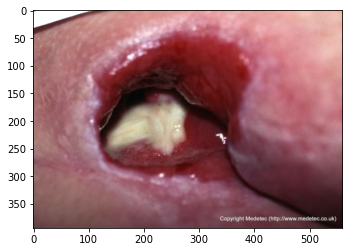

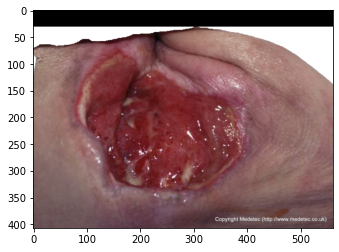

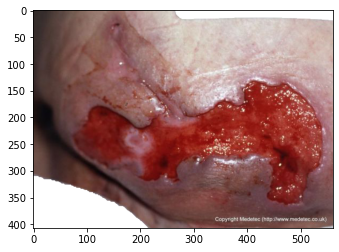

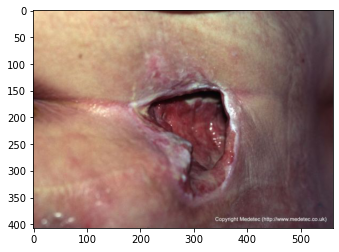

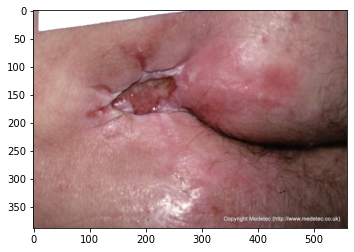

...

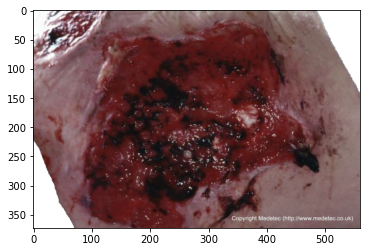

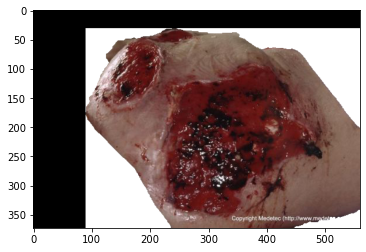

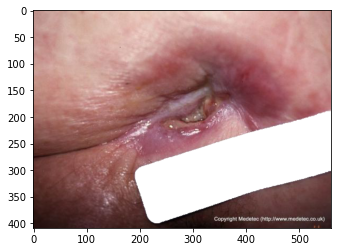

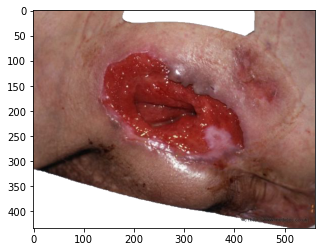

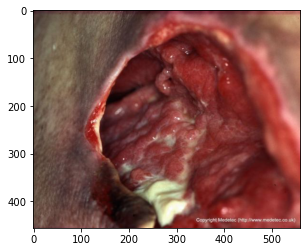

In [54]:
# initialise empty array to hold manually segmented skin

manual_skin_segment= []

# create path object that specifies the directory and file type our model wishes to target 
manual_segment_directory = glob.glob("Manually isolated Skin/*.png")

# read manually segmented skin images into Python (26 manually segmented skin images)
for item in manual_segment_directory:
    
    img = cv2.imread(item)
    
    rgb_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    manual_skin_segment.append(rgb_img)
    
    plt.imshow(rgb_img)
    plt.show()


In [73]:
# Initialise empty arrays to hold the image to array conversions of manual and model segmented skin
manual_wound_array = []
YCbCr_wound_array = []

# Iterate over the manual skin segments and convert them into arrays
for item in manual_skin_segment:
    img_array = img_to_array(item)
    manual_wound_array.append(img_array)
    
# Iterate over the model skin segments and convert them into arrays
for item in YCbCr_skin_dataset:
    img_array = img_to_array(item)
    YCbCr_wound_array.append(img_array)

# Declare value interation_count used to compare corresponding indexed values from model_wound_array
# as well as label results of Intersection over Union scores
iteration_count = 0

# Declare iou_array that holds the results of Intersection Over Union
iou_array = []
    
for item in manual_wound_array:
    intersection = np.logical_and(item, YCbCr_wound_array[iteration_count])
    union = np.logical_or(item, YCbCr_wound_array[iteration_count])

    IOU = np.sum(intersection) / np.sum(union)
    iou_array.append(IOU)
    print("The Intersection Over Union Score for image:" + " " + str(iteration_count) + " = " + str(IOU))
    iteration_count+=1

The Intersection Over Union Score for image: 0 = 0.9549926574123875
The Intersection Over Union Score for image: 1 = 0.9306868374384547
The Intersection Over Union Score for image: 2 = 0.7714535594568823
The Intersection Over Union Score for image: 3 = 0.9740984930032293
The Intersection Over Union Score for image: 4 = 0.9660091251906195
The Intersection Over Union Score for image: 5 = 0.8597853643770066
The Intersection Over Union Score for image: 6 = 0.8570858905080488
The Intersection Over Union Score for image: 7 = 0.8537557037557038
The Intersection Over Union Score for image: 8 = 0.8202273460174138
The Intersection Over Union Score for image: 9 = 0.8265796434051718
The Intersection Over Union Score for image: 10 = 0.9327728165729746
The Intersection Over Union Score for image: 11 = 0.9951451588784505
The Intersection Over Union Score for image: 12 = 0.8214067944250871
The Intersection Over Union Score for image: 13 = 0.46688390610162267
The Intersection Over Union Score for image

In [74]:
average_score = sum(iou_array) / len(iou_array)
print(average_score)

0.8386124801756368


Average score of 83% demonstrates the model is performing quite well at this stage but this is only the score of IOU before gap filling models have been implemented which will substantially increase the score for each segmentation.

# Gap filling and sematic corrections

The following are examples of gap filling algorithms the technical team has been tinkering with. Currently we are struggling with using Marker based watershed techniques to fulfill gap filling functions as described in the documentation provided by SAP. 

Additionally, our CV2 Floodfill implementation usually fills ALL empty pockets segmented out in our mask model, often times outputting the original image. We are investigating ways to make the model only fill gaps that exist within the perimeter of our skin segmentation.

## Marker Based Watershed

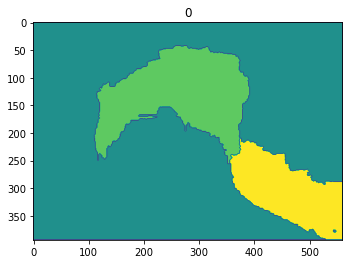

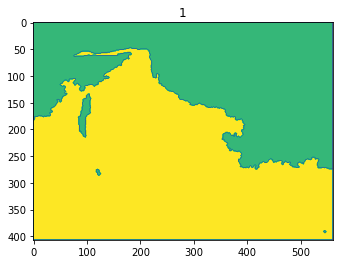

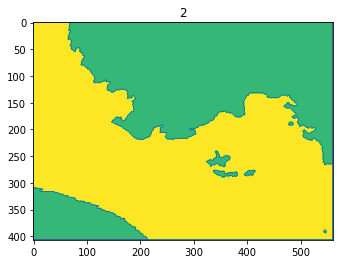

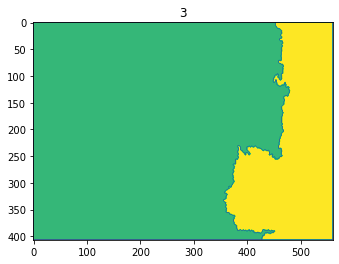

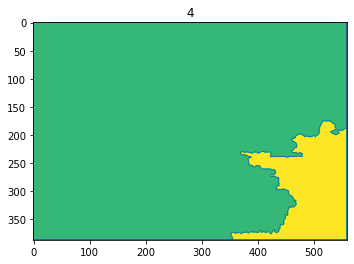

...

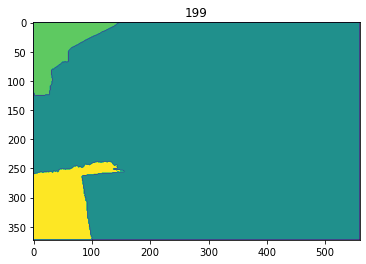

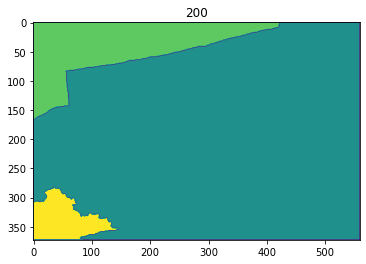

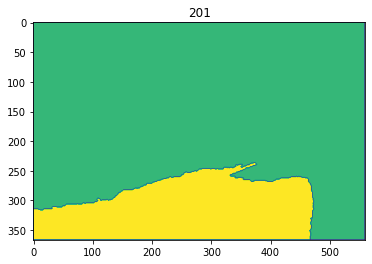

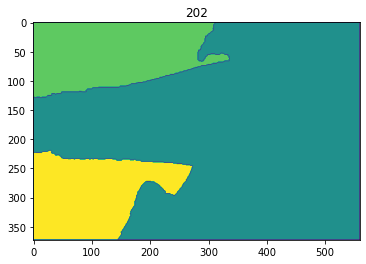

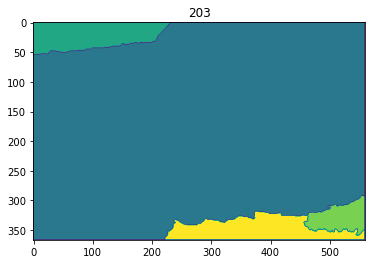

In [27]:
image_count = 0

for image in wound_dataset:
    gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
    ret, thresh = cv2.threshold(gray,0,255,cv2.THRESH_BINARY_INV+cv2.THRESH_OTSU)
    
    # noise removal
    kernel = np.ones((3,3),np.uint8)
    opening = cv2.morphologyEx(thresh,cv2.MORPH_OPEN,kernel, iterations = 2)

    # sure background area
    sure_bg = cv2.dilate(opening,kernel,iterations=3)

    # Finding sure foreground area
    dist_transform = cv2.distanceTransform(opening,cv2.DIST_L2,5)
    ret, sure_fg = cv2.threshold(dist_transform,0.7*dist_transform.max(),255,0)

    # Finding unknown region
    sure_fg = np.uint8(sure_fg)
    unknown = cv2.subtract(sure_bg,sure_fg)
    
    # Marker labelling
    ret, markers = cv2.connectedComponents(sure_fg)

    # Add one to all labels so that sure background is not 0, but 1
    markers = markers+1

    # Now, mark the region of unknown with zero
    markers[unknown==255] = 0
    
    markers = cv2.watershed(image,markers)
    image[markers == -1] = [255,0,0]
    
    plt.imshow(markers)
    plt.title(image_count)
    plt.show()
    image_count+=1

## CV2 FloodFilling Attempt

In [75]:
# Read image
im_in = cv2.imread("Wound_Dataset/Pressure Sores/pressure-ulcer-on-foot-0019.jpg", cv2.IMREAD_GRAYSCALE);

# Threshold.
# Set values equal to or above 220 to 0.
# Set values below 220 to 255.

th, im_th = cv2.threshold(im_in, 220, 255, cv2.THRESH_BINARY_INV);

# Copy the thresholded image.
im_floodfill = im_th.copy()

# Mask used to flood filling.
# Notice the size needs to be 2 pixels than the image.
h, w = im_th.shape[:2]
mask = np.zeros((h+2, w+2), np.uint8)

# Floodfill from point (0, 0)
cv2.floodFill(im_floodfill, mask, (0,0), 255);

# Invert floodfilled image
im_floodfill_inv = cv2.bitwise_not(im_floodfill)

# Combine the two images to get the foreground.
im_out = im_th | im_floodfill_inv

# Display images.
cv2.imshow("Thresholded Image", im_th)
cv2.imshow("Floodfilled Image", im_floodfill)
cv2.imshow("Inverted Floodfilled Image", im_floodfill_inv)
cv2.imshow("Foreground", im_out)
cv2.waitKey(0)

-1